In [132]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

Recebendo inputs do kaggle e separando em pastas

Importando dependências

In [133]:
# Importe pacotes

import os
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import random
import shutil

In [134]:
# Caminhos para as pastas
train_color_dir = "/kaggle/input/train-original"
train_label_dir = "/kaggle/input/train-label"
val_color_dir = "/kaggle/input/val-original"
val_label_dir = "/kaggle/input/val-label"
test_color_dir = "/kaggle/input/test-original"
test_label_dir = "/kaggle/input/test-label"

In [135]:
# Listar imagens (assumindo que os pares têm o mesmo nome de arquivo)
train_color_images = sorted(os.listdir(train_color_dir))
val_color_images = sorted(os.listdir(val_color_dir))
test_color_images = sorted(os.listdir(test_color_dir))

train_label_images = sorted(os.listdir(train_label_dir))
val_label_images = sorted(os.listdir(val_label_dir))
test_label_images = sorted(os.listdir(test_label_dir))

# Extraindo nomes dos arquivos (sem a extensão)
train_names = [os.path.splitext(img)[0] for img in train_color_images]
val_names = [os.path.splitext(img)[0] for img in val_color_images]
test_names = [os.path.splitext(img)[0] for img in test_color_images]

train_names_labels = [os.path.splitext(img)[0] for img in train_label_images]
val_names_labels = [os.path.splitext(img)[0] for img in val_label_images]
test_names_labels = [os.path.splitext(img)[0] for img in test_label_images]




Preparando imagens

In [136]:
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image

# Definindo transformações para as imagens
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Redimensiona as imagens para um tamanho fixo
    transforms.ToTensor()  # Converte as imagens para tensores
])

# Classe customizada para carregar as imagens
class CustomDataset(Dataset):
    def __init__(self, label_dir, color_dir, image_names, label_names, transform=None):
        self.label_dir = label_dir
        self.color_dir = color_dir
        self.image_names = image_names
        self.label_names = label_names
        self.transform = transform

    def __len__(self):
        return len(self.image_names)

    def __getitem__(self, idx):
        label_image_path = os.path.join(self.label_dir, f"{self.label_names[idx]}.png")
        color_image_path = os.path.join(self.color_dir, f"{self.image_names[idx]}.png")

        label_image = Image.open(label_image_path).convert("RGB")
        color_image = Image.open(color_image_path).convert("RGB")

        if self.transform:
            label_image = self.transform(label_image)
            color_image = self.transform(color_image)

        return label_image, color_image

# Criando datasets
train_dataset = CustomDataset(train_label_dir, train_color_dir, train_names, train_names_labels, transform=transform)
val_dataset = CustomDataset(val_label_dir, val_color_dir, val_names, val_names_labels, transform=transform)
test_dataset = CustomDataset(test_label_dir, test_color_dir, test_names, test_names_labels, transform=transform)

# Criando DataLoaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=True, num_workers=0, pin_memory=True)

print("DataLoaders criados com sucesso!")

DataLoaders criados com sucesso!


Definindo Gerador

In [137]:
# U-Net

import torch
import torch.nn as nn
import torch.nn.functional as F

class UNet(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super(UNet, self).__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Decoder
        self.decoders = nn.ModuleList([self.conv_transpose(self.n_channels * (2 ** (i+2)), self.n_channels * (2 ** i)) for i in range(self.depth-2, -1, -1)])

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels, 3, kernel_size=1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True),  # Função de ativação (zera os valores negativos)
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")
        # Decoder pass
        for i, decoder in enumerate(self.decoders):
            #print("i: ", i)
            #print("decoder: ", decoder)
            encoder_feature = encoders_features[-(i+1)]
            encoder_feature = self.crop(encoder_feature, x)  # Aplica o crop nas feature maps
            #print(f"Encoder feature {i+1} after crop: {encoder_feature.shape}")

            if i != 0:
                x = torch.cat([encoder_feature, x], dim=1)  # Concatena encoder com decoder
                #print(f"After concatenation with encoder feature {i+1}: {x.shape}")

            x = decoder(x)

        # Final convolution
        x = self.final_conv(x)
        x = F.interpolate(x, size=(self.image_dim[2], self.image_dim[3]), mode='bilinear', align_corners=False)
        #print(f"Output shape after final convolution: {x.shape}")
        
        x = torch.sigmoid(x)
        
        return x

Testando gerador

Gerador gera uma imagem do tamanho desejado, passando pela unet

Discriminador

In [138]:

class Discriminator(nn.Module):
    def __init__(self, image_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1):
        super().__init__()

        self.image_dim = image_dim  # Dimensões da imagem de entrada (C, H, W)
        self.depth = depth 
        self.n_channels = n_channels
        self.conv_kernel_size = conv_kernel_size
        self.conv_stride = conv_stride
        self.conv_padding = conv_padding
        self.pool_kernel_size = pool_kernel_size
        self.pool_stride = pool_stride
        self.pool_padding = pool_padding
        self.transpose_kernel_size = transpose_kernel_size
        self.transpose_stride = transpose_stride
        self.transpose_padding = transpose_padding

        # Encoder
        self.encoders = nn.ModuleList([self.conv_block(3 if i == 0 else self.n_channels * (2 ** (i-1)), self.n_channels * (2 ** i)) for i in range(self.depth)])
        self.pool = nn.MaxPool2d(kernel_size=self.pool_kernel_size, stride=self.pool_stride, padding=self.pool_padding)

        # Bottleneck
        self.bottleneck = self.conv_block(self.n_channels * (2 ** (self.depth-1)), self.n_channels * (2 ** self.depth))

        # Final conv layer
        self.final_conv = nn.Conv2d(self.n_channels * (2 ** self.depth), 1, kernel_size=1)

        # Fully connected layer to reduce the dimensions to [32, 1, 1, 1]
        self.fc = nn.Linear(self.image_dim[2] * self.image_dim[3], 1)

    def conv_block(self, in_channels, out_channels):
        # Camada convolucional com normalização e função de ativação; 2 vezes
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),  # Normalização para acelerar o treinamento
            nn.ReLU(inplace=True)  # Função de ativação (zera os valores negativos)
        )
    
        """
            nn.Conv2d(out_channels, out_channels, kernel_size=self.conv_kernel_size, stride=self.conv_stride, padding=self.conv_padding),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        """

    def crop(self, encoder_feature, decoder_feature):
        _, _, h, w = decoder_feature.size()
        encoder_feature = F.interpolate(encoder_feature, size=(h, w), mode='bilinear', align_corners=False)  # Redimensiona a feature map do encoder
        return encoder_feature

    def conv_transpose(self, in_channels, out_channels):
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=self.transpose_kernel_size, stride=self.transpose_stride, padding=self.transpose_padding),
            self.conv_block(out_channels, out_channels)
        )
    
    def forward(self, x):
        #print(f"Input shape: {x.shape}")
        encoders_features = []

        # Encoder pass
        for idx, encoder in enumerate(self.encoders):
            #print("idx: ", idx)
            #print("encoder: ", encoder)
            x = encoder(x)
            encoders_features.append(x)
            #print(f"After encoder block {idx+1}: {x.shape}")
            x = self.pool(x)
            #print(f"After pooling {idx+1}: {x.shape}")

        # Bottleneck
        x = self.bottleneck(x)
        #print(f"After bottleneck: {x.shape}")
        # Doubled the block
        #print("Starting decoder pass")

        # Final convolution
        x = self.final_conv(x)
        x = F.interpolate(x, size=(1, 1), mode='bilinear', align_corners=False)
        #print(f"Output shape after final convolution: {x.shape}")
        x = torch.sigmoid(x)


        return x

Treino

In [139]:
from torch.optim import Adam, SGD
from torch.nn import BCELoss, L1Loss, MSELoss
import time

# Loss para o discriminador
d_loss = BCELoss()

class GeneratorLoss(nn.Module):
    def __init__(self, lambda_l1=100):
        super(GeneratorLoss, self).__init__()
        # Definir a perda BCE (usada para a parte adversária)
        self.adversarial_loss = nn.MSELoss()
        # Definir a perda L1
        self.l1_loss = nn.L1Loss()
        # Peso da perda L1
        self.lambda_l1 = lambda_l1

    def forward(self, yhat_fake, fake_images, real_images):
        """
        Parâmetros:
        - yhat_fake: As previsões do discriminador sobre as imagens geradas (fake)
        - fake_images: Imagens geradas pelo gerador
        - real_images: Imagens reais de referência
        
        Retorna:
        - A perda total combinando perda adversária e L1
        """
        # Perda adversária: tentar fazer o discriminador acreditar que as imagens geradas são reais
        adversarial_loss = self.adversarial_loss(yhat_fake, torch.ones_like(yhat_fake))
        
        # Perda L1: minimizar a diferença entre as imagens geradas e as reais
        l1_loss = self.l1_loss(fake_images, real_images)
        
        # Perda total: adversária + ponderação da perda L1
        total_loss = adversarial_loss + self.lambda_l1 * l1_loss
        
        return total_loss

g_loss = GeneratorLoss()
#g_loss = CycleGANLoss()

# Normalize the input values to be between 0 and 1
def normalize(tensor):
    return (tensor - tensor.min()) / (tensor.max() - tensor.min())


In [140]:
class PaisagemGAN(nn.Module):
    def __init__(self, generator, discriminator):
        super(PaisagemGAN, self).__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.global_step = 0

    def compile(self, g_loss, d_loss):
        self.g_loss = g_loss
        self.d_loss = d_loss
        self.g_opt = Adam(self.generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
        self.d_opt = SGD(self.discriminator.parameters(), lr=0.0002, momentum=0.0)

    def train_step(self, real_images, grey_images):
        
        # Train the discriminator
        #inicio = time.time()
        self.d_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_real = self.discriminator(real_images)
        yhat_fake = self.discriminator(fake_images)
        
        # Suavização de rótulos para imagens reais (usando 0.9 ao invés de 1.0)
        d_loss_real = self.d_loss(yhat_real, torch.full_like(yhat_real, 0.9))
        # Suavização opcional de rótulos para imagens falsas (usando 0.1 ao invés de 0.0)
        d_loss_fake = self.d_loss(yhat_fake, torch.full_like(yhat_fake, 0.1))
        # Soma das perdas
        total_d_loss = d_loss_real + d_loss_fake
        total_d_loss.backward()
        
        # Update discriminator weights every 5 steps
        if self.global_step % 5 == 0:
            self.d_opt.step()
        
        self.global_step += 1
        #fim = time.time()
        #print(fim - inicio)

        # Train the generator
        #inicio = time.time()
        self.g_opt.zero_grad()
        
        fake_images = self.generator(grey_images)
        yhat_fake = self.discriminator(fake_images)
        total_g_loss = self.g_loss(yhat_fake, fake_images, real_images)
        
        total_g_loss.backward()
        self.g_opt.step()
        #fim = time.time()
        #print(fim - inicio)
        
        return {'d_loss': total_d_loss.item(), 'g_loss': total_g_loss.item(), 'gen': fake_images}

Realizar treinamento

In [141]:
nex = next(iter(train_loader))
img_dim = nex[0].shape
print(img_dim)

gene = UNet(image_dim=img_dim, n_channels=64, depth=5, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
gene = gene.to(device)  # Mover o modelo para o dispositivo

disc = Discriminator(image_dim=img_dim, n_channels=64, depth=3, conv_kernel_size=3, conv_stride=1, conv_padding=1, pool_kernel_size=2, pool_stride=2, pool_padding=0, transpose_kernel_size=3, transpose_stride=2, transpose_padding=1)
# Configurando o dispositivo (GPU, se disponível)
#device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Dispositivo: {device}")
disc = disc.to(device)  # Mover o modelo para o dispositivo

torch.Size([16, 3, 256, 256])
Dispositivo: cuda
Dispositivo: cuda


In [142]:
def save_checkpoint(model, optimizer, epoch, batch, loss, filepath='checkpoint.pth'):
    checkpoint = {
        'epoch': epoch,
        'batch': batch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'loss': loss
    }
    torch.save(checkpoint, filepath)

Iniciar treinamento
Epoch [1/100], d_loss: 1.6851, g_loss: 21.6907, val_loss: 17.2926
39.78169345855713


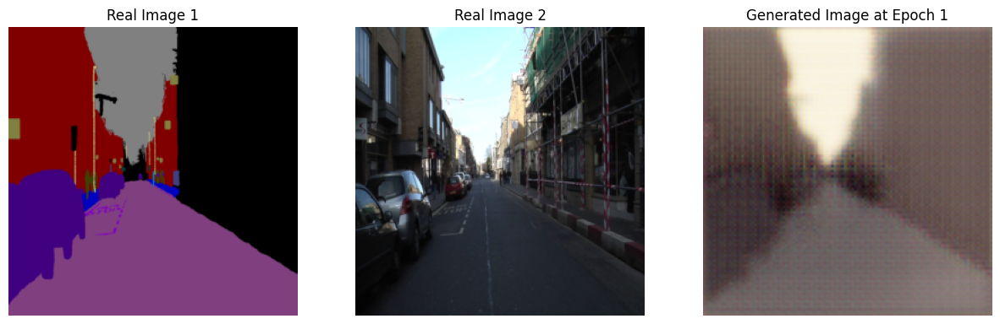

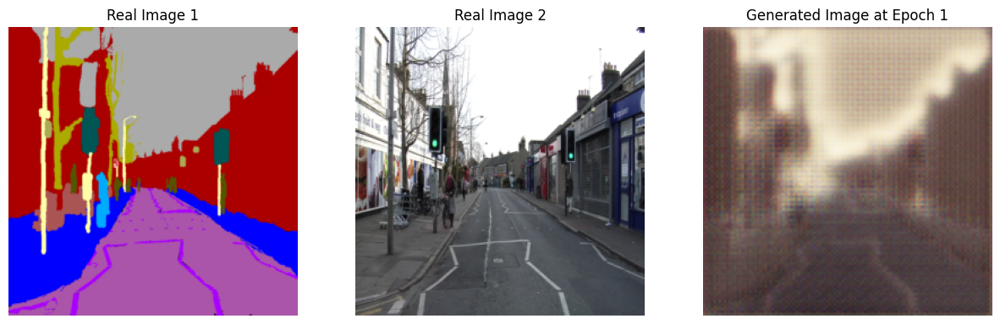

Epoch [2/100], d_loss: 1.7788, g_loss: 18.3069, val_loss: 15.0751
38.395360469818115
Epoch [3/100], d_loss: 1.8413, g_loss: 13.9618, val_loss: 14.9922
38.51913070678711
Epoch [4/100], d_loss: 1.5327, g_loss: 19.7634, val_loss: 13.7159
38.428632736206055
Epoch [5/100], d_loss: 1.7612, g_loss: 10.4065, val_loss: 13.1518
38.36559772491455


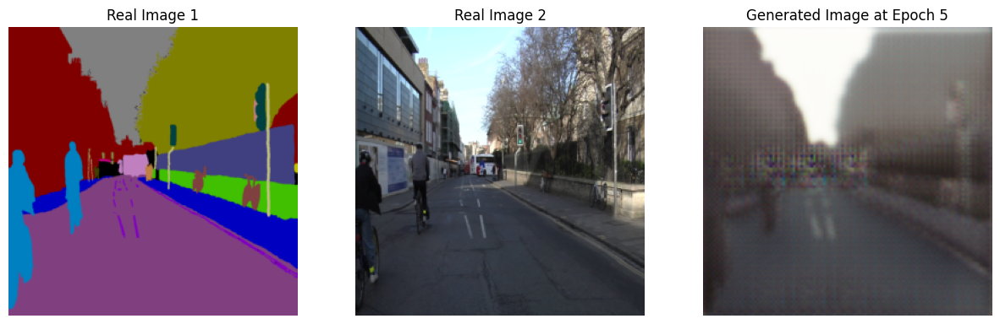

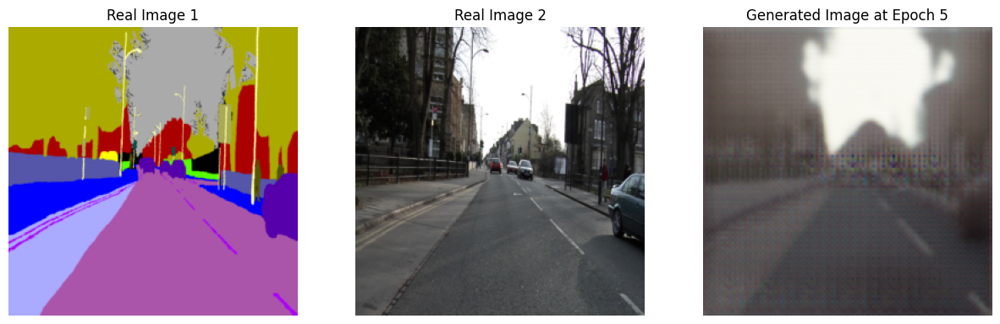

Epoch [6/100], d_loss: 1.7820, g_loss: 17.8798, val_loss: 12.6834
38.60457992553711
Epoch [7/100], d_loss: 1.7201, g_loss: 17.9295, val_loss: 13.0575
38.45986771583557
Epoch [8/100], d_loss: 1.7558, g_loss: 10.7424, val_loss: 13.7421
38.67317605018616
Epoch [9/100], d_loss: 1.5272, g_loss: 14.6294, val_loss: 12.7666
38.743263721466064
Epoch [10/100], d_loss: 1.5965, g_loss: 10.6900, val_loss: 11.2557
38.452953815460205


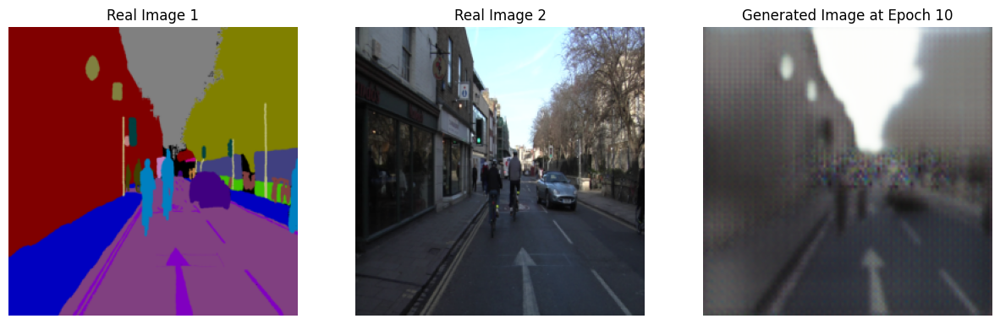

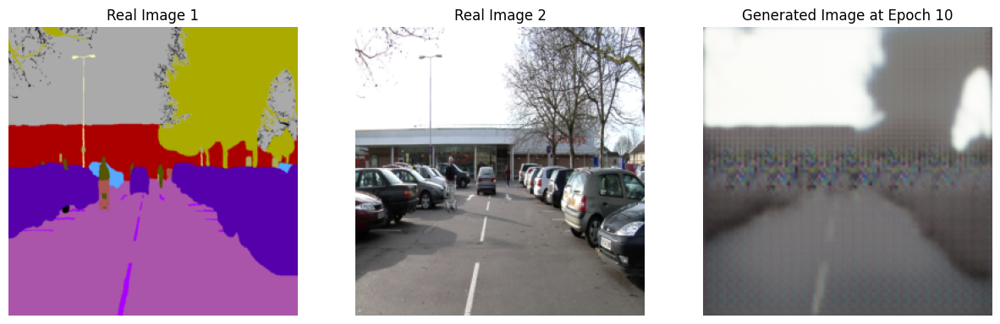

Epoch [11/100], d_loss: 1.8410, g_loss: 8.5337, val_loss: 12.4490
38.79806733131409
Epoch [12/100], d_loss: 1.8369, g_loss: 9.5327, val_loss: 11.3733
38.360193967819214
Epoch [13/100], d_loss: 1.5268, g_loss: 21.1967, val_loss: 11.0610
38.591973304748535
Epoch [14/100], d_loss: 1.6684, g_loss: 8.7075, val_loss: 11.3286
38.87232232093811
Epoch [15/100], d_loss: 1.6136, g_loss: 15.8086, val_loss: 10.9730
38.43016481399536


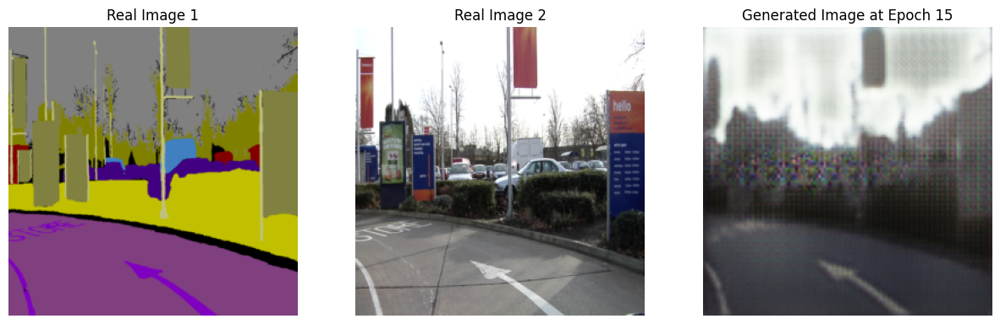

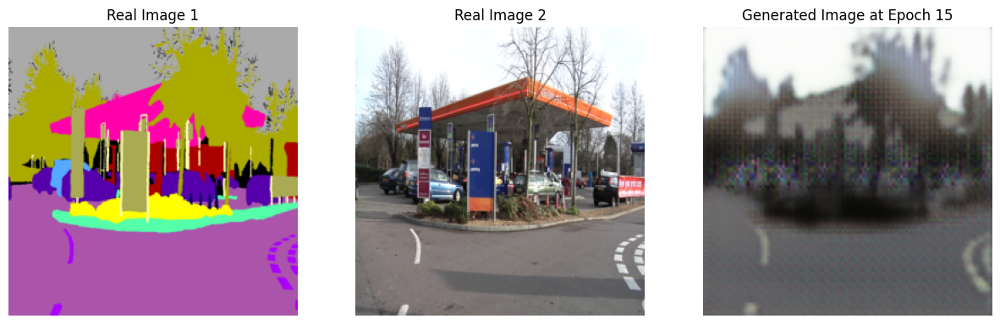

Epoch [16/100], d_loss: 1.3518, g_loss: 15.1355, val_loss: 11.3695
38.586623668670654
Epoch [17/100], d_loss: 1.7391, g_loss: 10.9674, val_loss: 13.3317
38.32861828804016
Epoch [18/100], d_loss: 1.8370, g_loss: 8.3423, val_loss: 11.9399
38.63457632064819
Epoch [19/100], d_loss: 1.7194, g_loss: 11.6085, val_loss: 10.6651
38.346853256225586
Epoch [20/100], d_loss: 2.0102, g_loss: 10.8124, val_loss: 10.8190
38.20616006851196


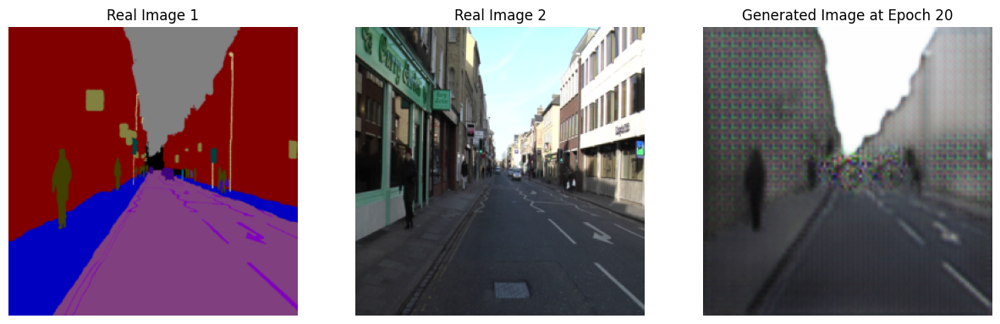

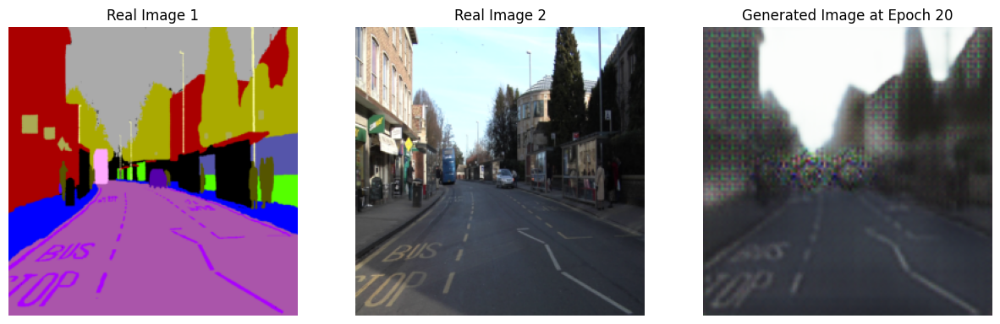

Epoch [21/100], d_loss: 1.8429, g_loss: 8.1697, val_loss: 9.9893
38.52766275405884
Epoch [22/100], d_loss: 1.7292, g_loss: 12.6172, val_loss: 9.4931
38.5174994468689
Epoch [23/100], d_loss: 1.5481, g_loss: 19.8219, val_loss: 11.0999
38.569782972335815
Epoch [24/100], d_loss: 2.2565, g_loss: 11.4276, val_loss: 10.4425
38.602880001068115
Epoch [25/100], d_loss: 2.2476, g_loss: 15.0523, val_loss: 10.4238
38.268354654312134


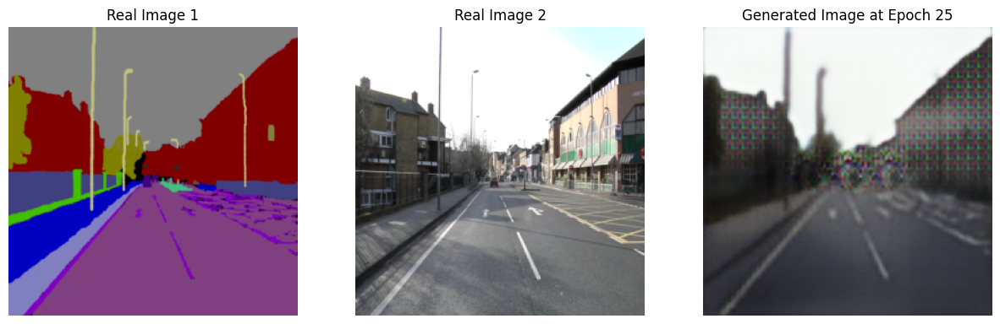

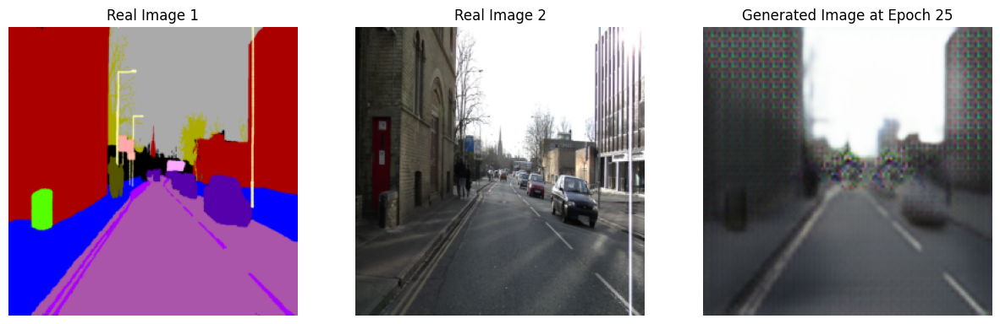

Epoch [26/100], d_loss: 1.3494, g_loss: 10.7840, val_loss: 10.4588
38.45576286315918
Epoch [27/100], d_loss: 2.1448, g_loss: 9.7289, val_loss: 14.1512
38.447612285614014
Epoch [28/100], d_loss: 1.6276, g_loss: 7.8195, val_loss: 10.7576
38.17999339103699
Epoch [29/100], d_loss: 1.9465, g_loss: 8.2482, val_loss: 9.3066
38.13702178001404
Epoch [30/100], d_loss: 1.4188, g_loss: 22.9966, val_loss: 10.0236
38.009971141815186


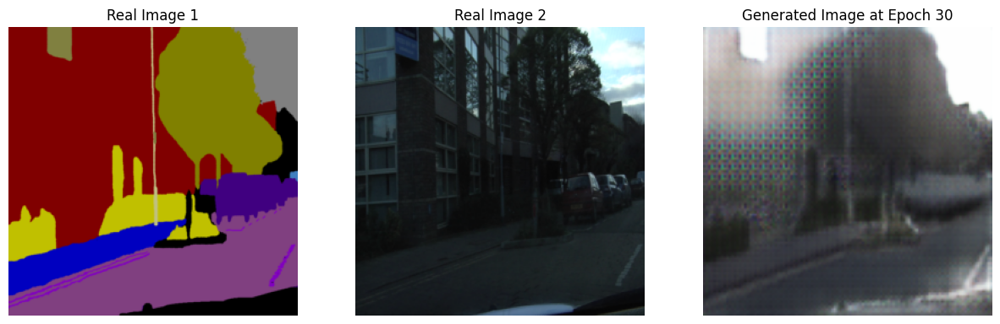

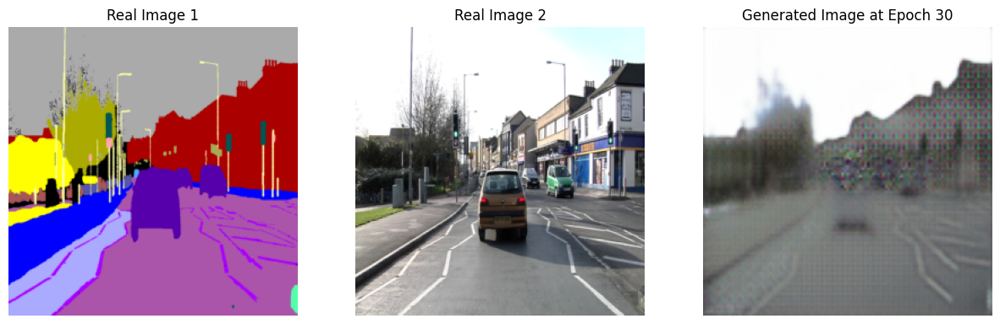

Epoch [31/100], d_loss: 1.4231, g_loss: 26.7384, val_loss: 9.7067
38.33751916885376
Epoch [32/100], d_loss: 1.5324, g_loss: 9.6116, val_loss: 9.4232
37.782527685165405
Epoch [33/100], d_loss: 1.7158, g_loss: 8.1434, val_loss: 9.8787
38.49265503883362
Epoch [34/100], d_loss: 1.7161, g_loss: 8.1147, val_loss: 10.7251
38.52079200744629
Epoch [35/100], d_loss: 1.5017, g_loss: 8.0376, val_loss: 8.9400
38.70087909698486


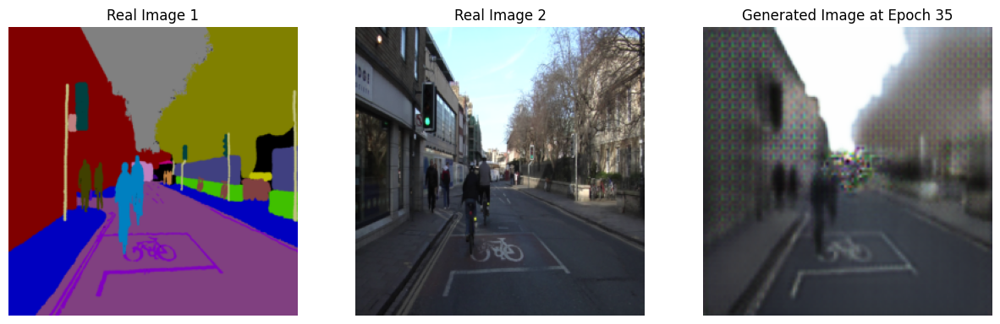

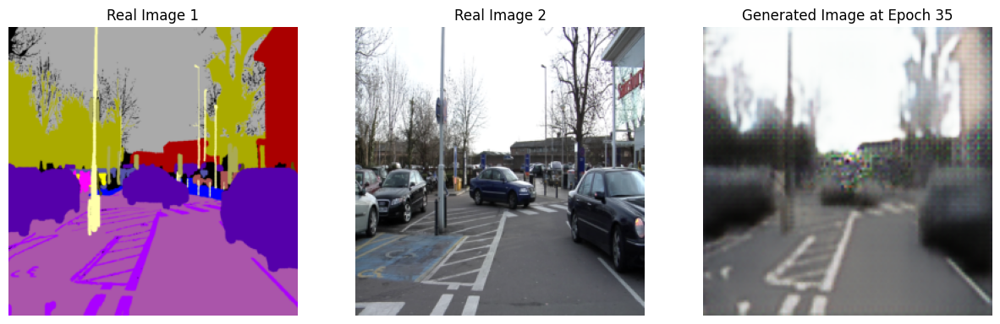

Epoch [36/100], d_loss: 1.8923, g_loss: 8.8866, val_loss: 10.3020
37.908581018447876
Epoch [37/100], d_loss: 1.4013, g_loss: 18.2028, val_loss: 9.2803
38.13245511054993
Epoch [38/100], d_loss: 1.3160, g_loss: 13.6101, val_loss: 10.2853
38.47698640823364
Epoch [39/100], d_loss: 1.7420, g_loss: 7.5836, val_loss: 9.7101
38.003722190856934
Epoch [40/100], d_loss: 1.6111, g_loss: 8.5044, val_loss: 8.8599
38.42965507507324


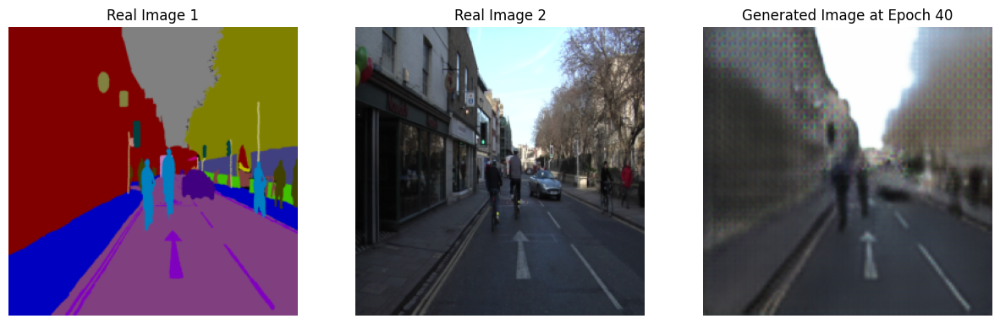

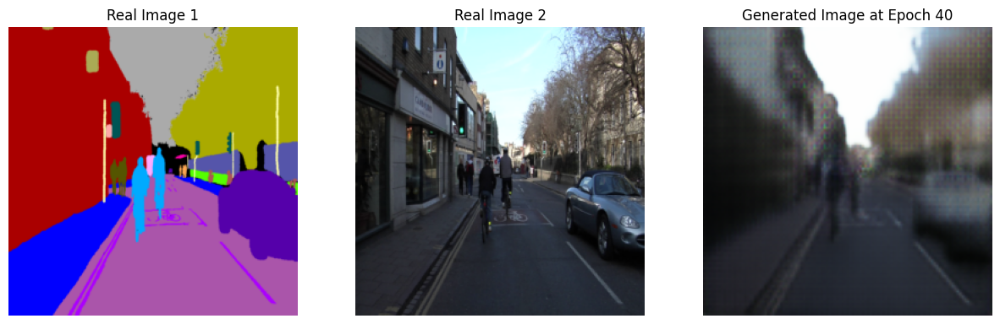

Epoch [41/100], d_loss: 1.6763, g_loss: 12.5132, val_loss: 10.4384
38.11645698547363
Epoch [42/100], d_loss: 1.4847, g_loss: 12.8775, val_loss: 9.7069
37.81446719169617
Epoch [43/100], d_loss: 1.7648, g_loss: 9.3282, val_loss: 9.0805
37.97165060043335
Epoch [44/100], d_loss: 1.7375, g_loss: 13.2940, val_loss: 9.5656
38.27809405326843
Epoch [45/100], d_loss: 1.5371, g_loss: 7.9618, val_loss: 8.7731
38.065585136413574


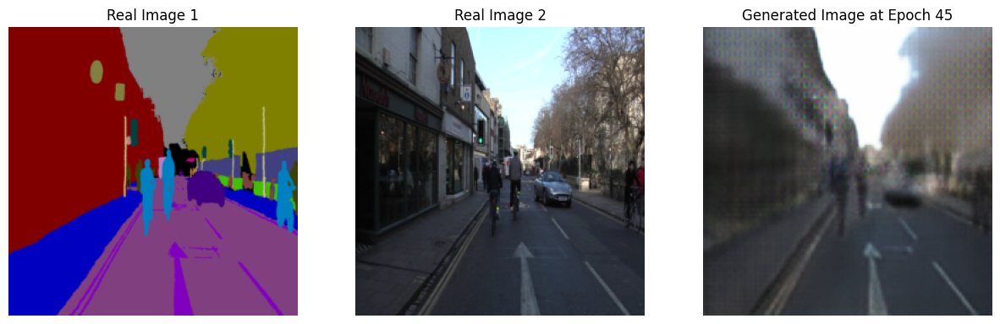

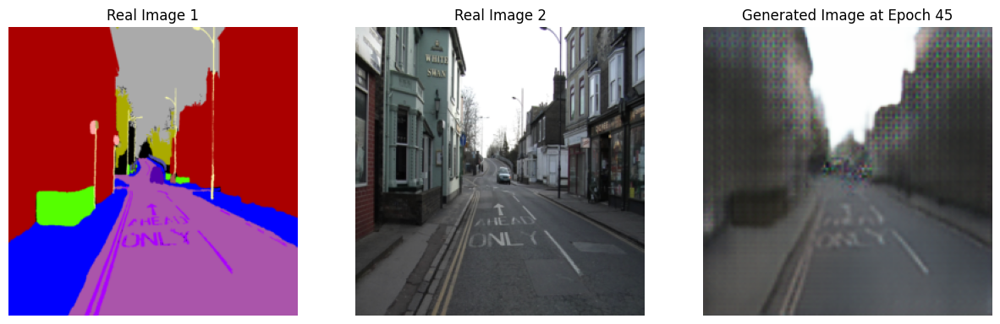

Epoch [46/100], d_loss: 1.8244, g_loss: 11.0825, val_loss: 9.6931
38.21254754066467
Epoch [47/100], d_loss: 1.7417, g_loss: 7.5041, val_loss: 10.1821
38.114816665649414
Epoch [48/100], d_loss: 1.6154, g_loss: 8.1276, val_loss: 8.7888
38.07718849182129
Epoch [49/100], d_loss: 1.5793, g_loss: 8.4374, val_loss: 9.2421
38.09648275375366
Epoch [50/100], d_loss: 1.4682, g_loss: 9.0989, val_loss: 9.9998
38.084609270095825


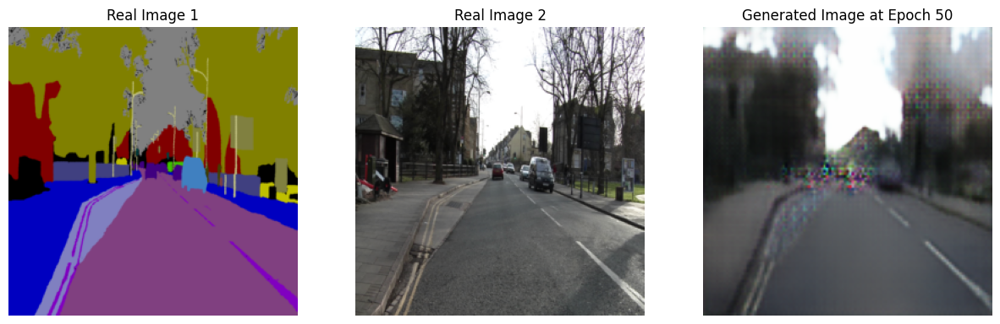

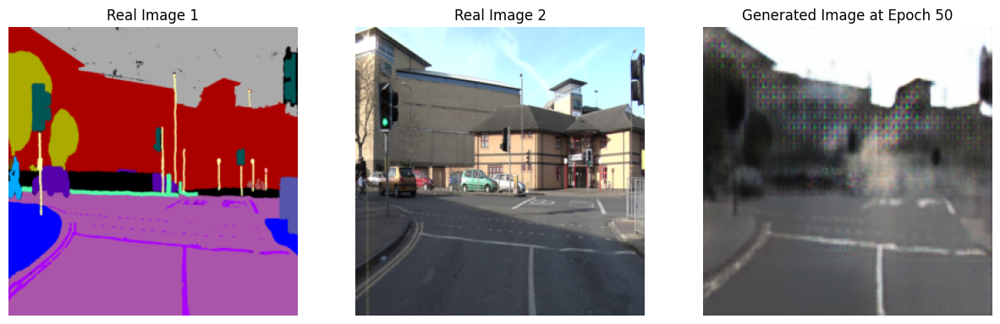

Epoch [51/100], d_loss: 1.4645, g_loss: 12.1791, val_loss: 9.1425
38.085906982421875
Epoch [52/100], d_loss: 1.3373, g_loss: 10.8014, val_loss: 9.4732
37.88993191719055
Epoch [53/100], d_loss: 1.0772, g_loss: 13.8147, val_loss: 11.0029
38.26885652542114
Epoch [54/100], d_loss: 1.3228, g_loss: 7.3979, val_loss: 10.2493
37.67103815078735
Epoch [55/100], d_loss: 1.4540, g_loss: 7.8184, val_loss: 8.7594
38.2162184715271


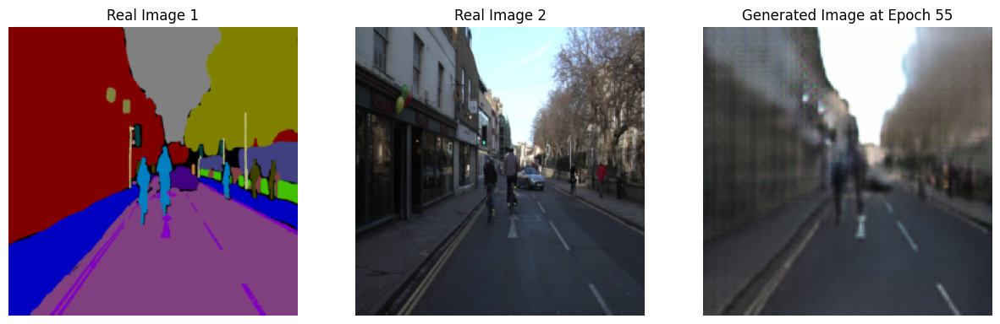

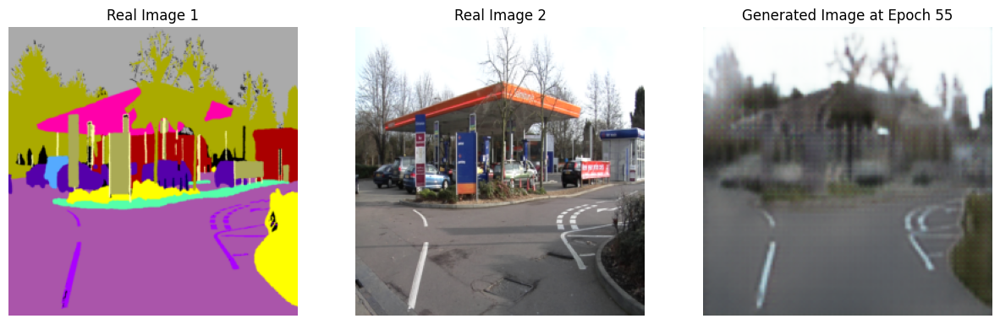

Epoch [56/100], d_loss: 1.7610, g_loss: 7.5358, val_loss: 10.2164
38.106724977493286
Epoch [57/100], d_loss: 1.5948, g_loss: 12.2379, val_loss: 8.7419
38.31511974334717
Epoch [58/100], d_loss: 1.5214, g_loss: 8.1480, val_loss: 9.4685
38.09315609931946
Epoch [59/100], d_loss: 1.1326, g_loss: 11.2455, val_loss: 10.2003
37.89149355888367
Epoch [60/100], d_loss: 1.4033, g_loss: 12.6137, val_loss: 9.2717
38.00288796424866


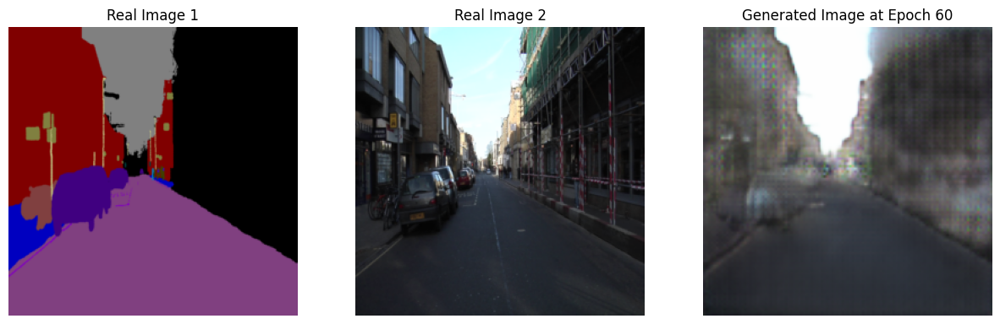

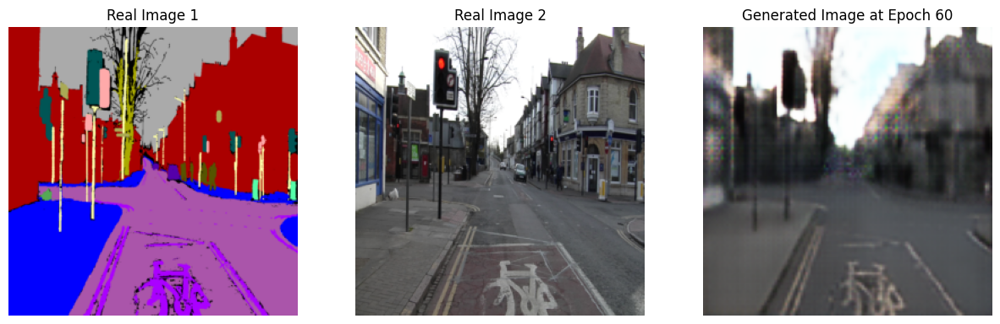

Epoch [61/100], d_loss: 1.3915, g_loss: 8.0868, val_loss: 9.2017
37.90900731086731
Epoch [62/100], d_loss: 1.3378, g_loss: 10.7332, val_loss: 10.4514
37.97382569313049
Epoch [63/100], d_loss: 1.2820, g_loss: 11.0884, val_loss: 11.1410
37.92306971549988
Epoch [64/100], d_loss: 1.4849, g_loss: 5.7859, val_loss: 8.9497
38.21889519691467
Epoch [65/100], d_loss: 1.5680, g_loss: 15.7382, val_loss: 15.6160
37.835081577301025


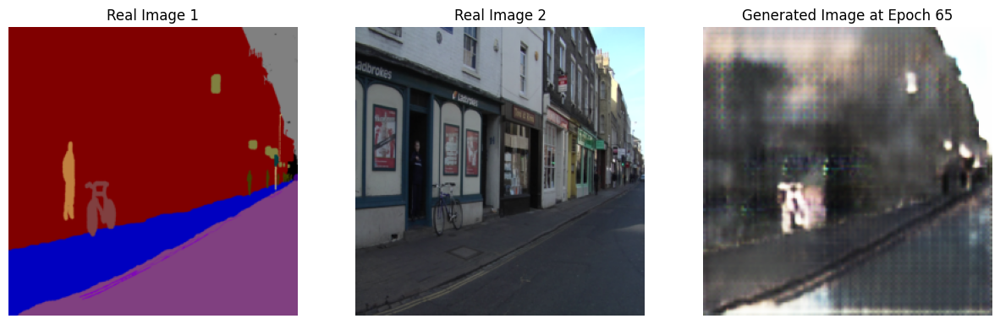

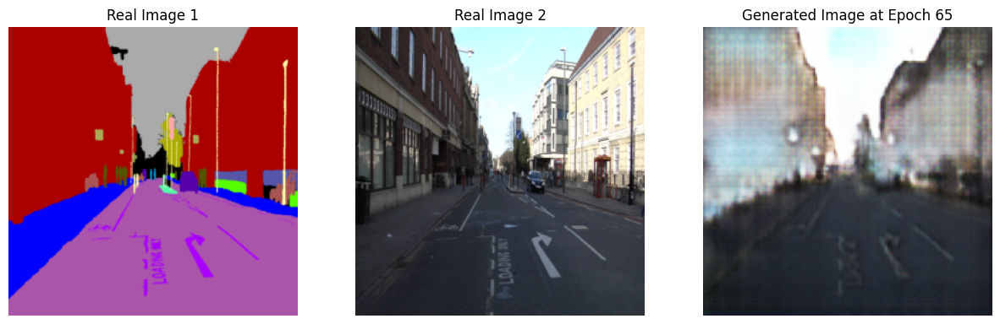

Epoch [66/100], d_loss: 1.5690, g_loss: 10.8389, val_loss: 9.7239
38.17864274978638
Epoch [67/100], d_loss: 1.4309, g_loss: 8.0045, val_loss: 10.4121
38.308610916137695
Epoch [68/100], d_loss: 1.6539, g_loss: 7.6066, val_loss: 8.9418
38.09582734107971
Epoch [69/100], d_loss: 1.4485, g_loss: 18.5789, val_loss: 9.8055
38.61762261390686
Epoch [70/100], d_loss: 1.5578, g_loss: 9.5489, val_loss: 9.5858
38.19863939285278


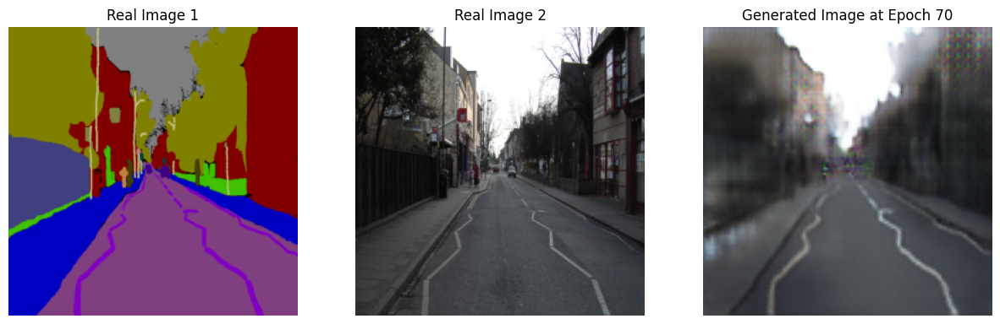

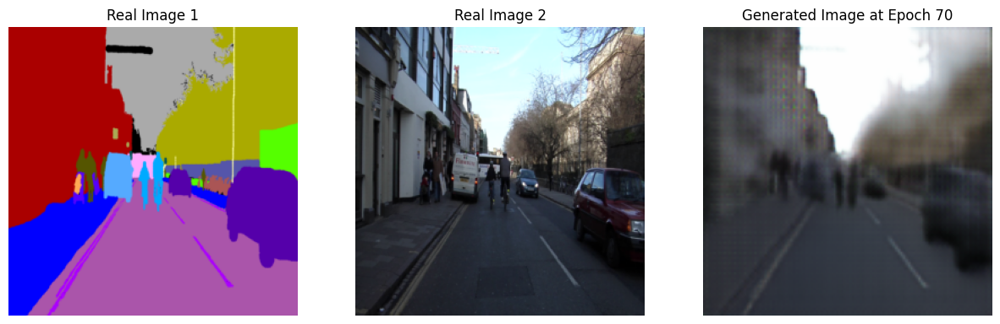

Epoch [71/100], d_loss: 1.4918, g_loss: 14.5984, val_loss: 9.0656
38.454264640808105
Epoch [72/100], d_loss: 1.0046, g_loss: 6.8855, val_loss: 9.2763
38.15393805503845
Epoch [73/100], d_loss: 1.2396, g_loss: 8.8445, val_loss: 8.9328
38.144451379776
Epoch [74/100], d_loss: 2.0443, g_loss: 12.2950, val_loss: 11.3205
38.067150592803955
Epoch [75/100], d_loss: 1.8677, g_loss: 7.3373, val_loss: 8.8020
38.3573522567749


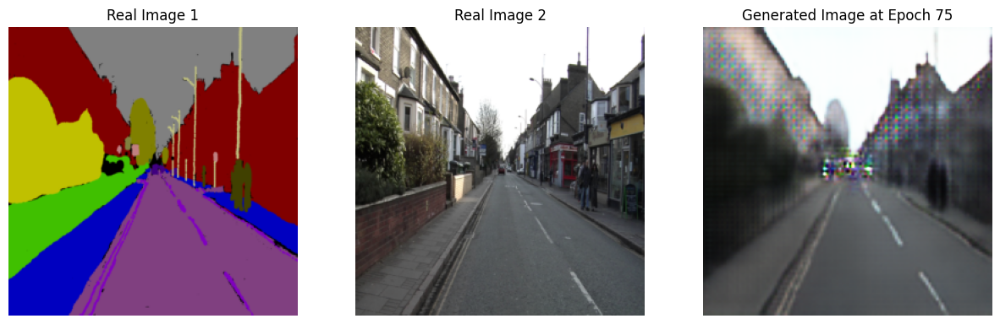

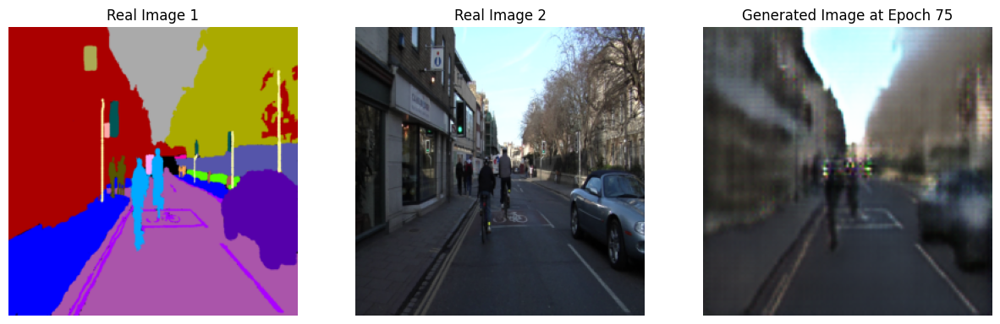

Epoch [76/100], d_loss: 1.6024, g_loss: 14.2188, val_loss: 11.1027
38.192972898483276
Epoch [77/100], d_loss: 1.4602, g_loss: 7.8369, val_loss: 10.7776
37.9404399394989
Epoch [78/100], d_loss: 1.3923, g_loss: 12.9559, val_loss: 10.6238
38.26924419403076
Epoch [79/100], d_loss: 1.4016, g_loss: 12.7591, val_loss: 10.4215
38.018622636795044
Epoch [80/100], d_loss: 1.6617, g_loss: 5.9847, val_loss: 8.8977
38.15155220031738


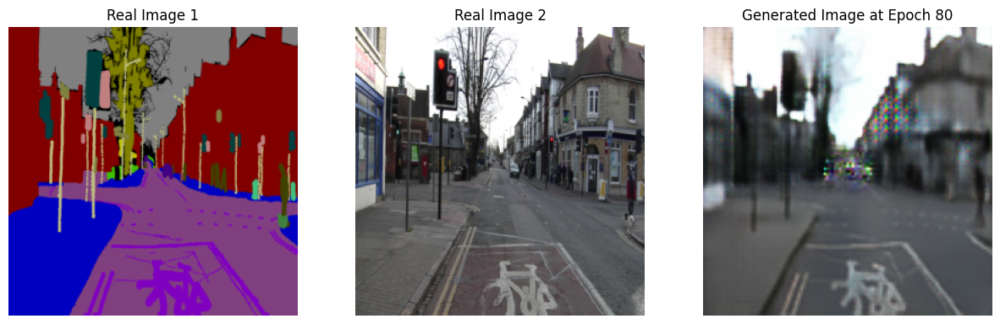

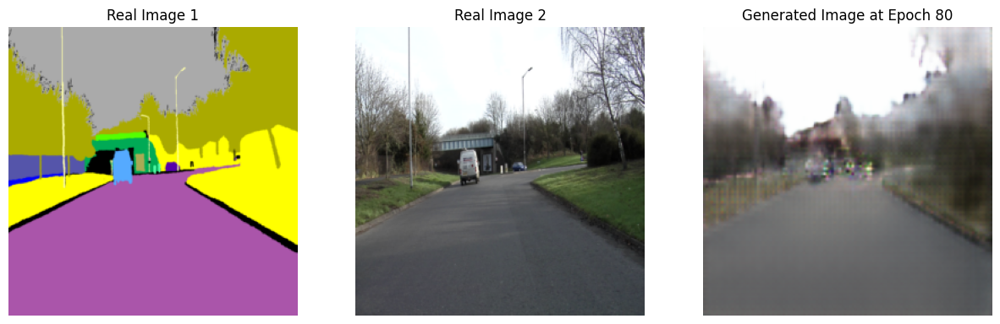

Epoch [81/100], d_loss: 1.3804, g_loss: 7.1701, val_loss: 8.5104
38.13855957984924
Epoch [82/100], d_loss: 1.5790, g_loss: 13.0019, val_loss: 10.0226
38.03721499443054
Epoch [83/100], d_loss: 1.4866, g_loss: 7.3454, val_loss: 8.9576
38.44170928001404
Epoch [84/100], d_loss: 1.3541, g_loss: 8.1802, val_loss: 8.9837
38.7167181968689
Epoch [85/100], d_loss: 1.2726, g_loss: 6.2408, val_loss: 8.5462
38.37824773788452


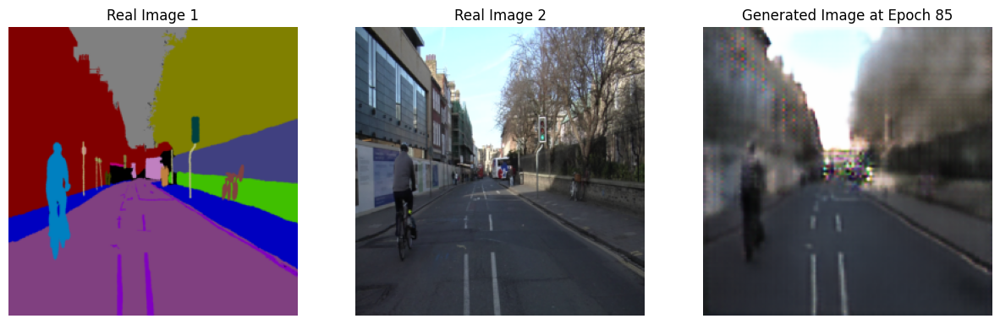

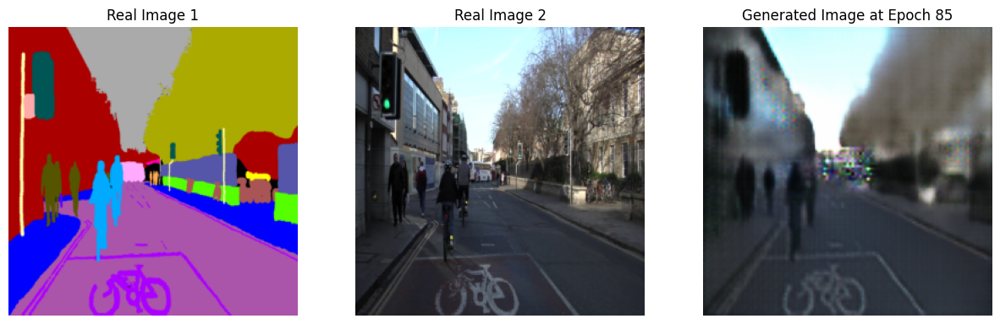

Epoch [86/100], d_loss: 1.7341, g_loss: 7.8383, val_loss: 8.9179
38.44592618942261
Epoch [87/100], d_loss: 1.4791, g_loss: 6.8994, val_loss: 8.5050
38.51075458526611
Epoch [88/100], d_loss: 1.8745, g_loss: 17.5734, val_loss: 14.9955
39.01278758049011
Epoch [89/100], d_loss: 1.2011, g_loss: 11.9446, val_loss: 10.9129
39.0492057800293
Epoch [90/100], d_loss: 1.2098, g_loss: 8.5591, val_loss: 10.7194
38.98563814163208


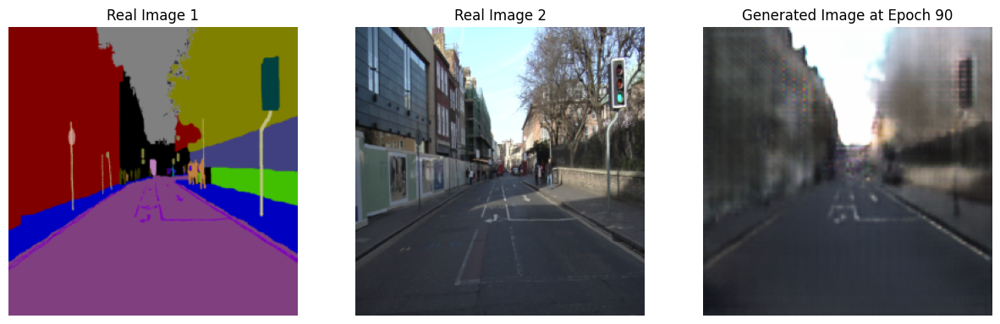

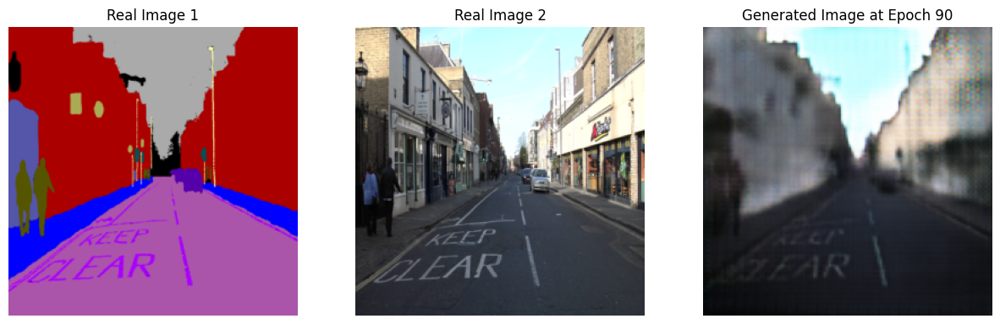

Epoch [91/100], d_loss: 1.1804, g_loss: 15.8827, val_loss: 11.9226
38.92316746711731
Epoch [92/100], d_loss: 1.2959, g_loss: 10.0154, val_loss: 10.0498
38.81095480918884
Epoch [93/100], d_loss: 1.1280, g_loss: 7.7650, val_loss: 8.7083
38.487306118011475
Epoch [94/100], d_loss: 1.2379, g_loss: 7.5793, val_loss: 9.1036
38.69032645225525
Epoch [95/100], d_loss: 1.6031, g_loss: 6.0339, val_loss: 9.1756
39.24790692329407


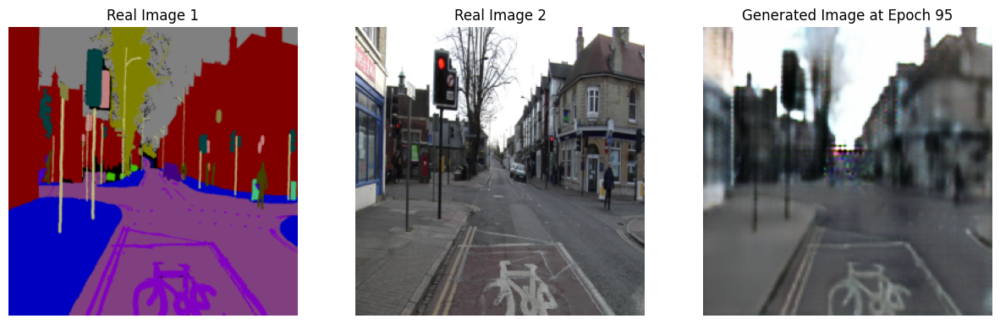

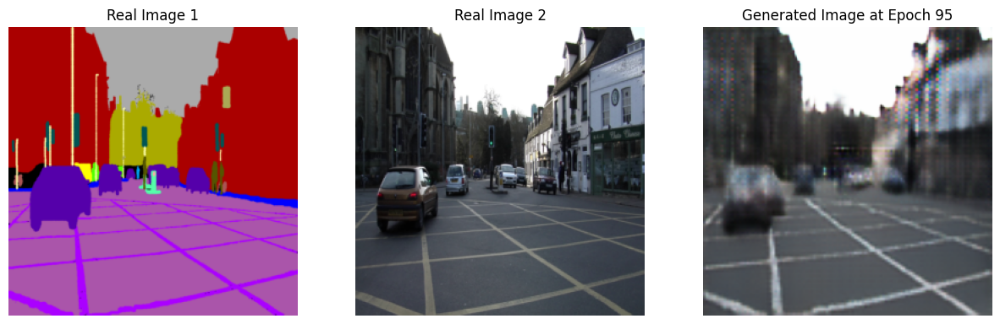

Epoch [96/100], d_loss: 1.7507, g_loss: 10.4990, val_loss: 9.7971
38.95461177825928
Epoch [97/100], d_loss: 1.2243, g_loss: 10.5121, val_loss: 9.2930
38.71174740791321
Epoch [98/100], d_loss: 1.7447, g_loss: 6.2526, val_loss: 8.9083
38.818909883499146
Epoch [99/100], d_loss: 1.3179, g_loss: 19.2138, val_loss: 9.7332
38.57396173477173
Epoch [100/100], d_loss: 1.4223, g_loss: 9.9596, val_loss: 9.0138
38.67180156707764


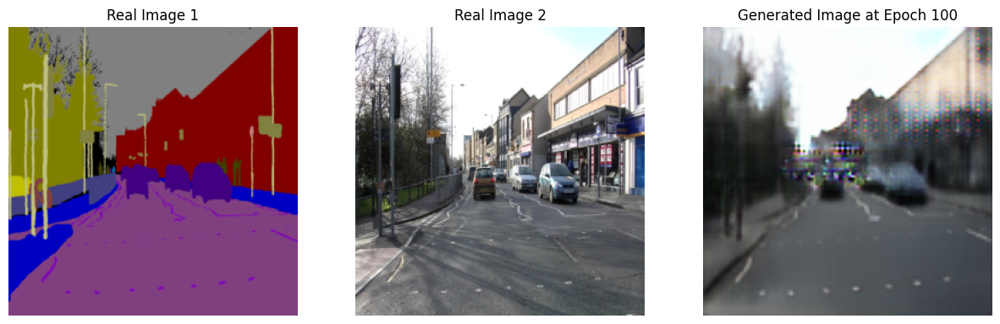

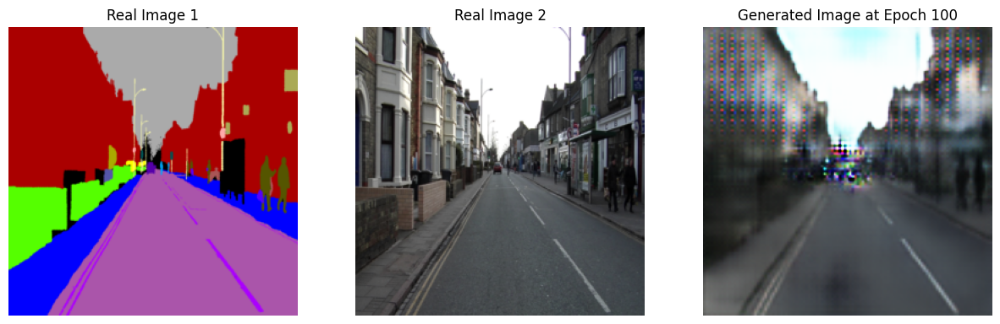

Treinamento concluído!


In [143]:
from matplotlib import pyplot as plt

# Instanciando o modelo GAN
gan = PaisagemGAN(generator=gene, discriminator=disc)
gan = gan.to(device)
gan.compile(g_loss=g_loss, d_loss=d_loss)

# Número de épocas
num_epochs = 100


# Loop de treinamento
print("Iniciar treinamento")
g_losses = []
d_losses = []
val_losses = []
for epoch in range(num_epochs):
    i = 0
    inicio = time.time()
    train_g_loss = 0.0
    train_d_loss = 0.0
    for batch in train_loader:
        real_images = normalize(batch[1].to(device))
        grey_images = normalize(batch[0].to(device))
        loss = gan.train_step(real_images, grey_images)
        i += 1
        train_g_loss += loss['g_loss']
        train_d_loss += loss['d_loss']
        real_images.cpu()
        grey_images.cpu()
    g_losses.append(train_g_loss/len(train_loader))
    d_losses.append(train_d_loss/len(train_loader))
    
    # Avaliação no conjunto de validação
    val_loss = 0.0
    with torch.no_grad():
        for val_batch in val_loader:
            val_real_images = normalize(val_batch[1].to(device))
            val_grey_images = normalize(val_batch[0].to(device))
            val_fake_images = gan.generator(val_grey_images)
            val_yhat_fake = gan.discriminator(val_fake_images)
            last_v_loss = g_loss(val_yhat_fake, val_fake_images, val_real_images)
            val_loss += last_v_loss.item()
            val_real_images.cpu()
            val_grey_images.cpu()
    
    val_loss /= len(val_loader)
    val_losses.append(val_loss)
    
    print(f"Epoch [{epoch+1}/{num_epochs}], d_loss: {loss['d_loss']:.4f}, g_loss: {loss['g_loss']:.4f}, val_loss: {val_loss:.4f}")
    fim = time.time()
    print(fim - inicio)

    if (epoch+1) % 5 == 0 or (epoch) == 0:
        save_checkpoint(gan.generator, gan.g_opt, epoch, batch, loss, filepath='/kaggle/working/gen.pth')
        save_checkpoint(gan.discriminator, gan.d_opt, epoch, batch, loss, filepath='/kaggle/working/disc.pth')

        # Desenhando evoluçao do treinamento
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (loss['gen'][0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (batch[0][0].detach().cpu().numpy().transpose(1, 2, 0)*255).astype('uint8')
        real_image2 = (batch[1][0].detach().cpu().numpy().transpose(1, 2, 0)*255 ).astype('uint8')

        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1)
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')  # Remove os eixos

        plt.show()

        # Desenhando evolução da validação
        # Convertendo as imagens geradas de 0-1 para 0-255
        gen_image = (val_fake_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')

        # Convertendo batch[0] e batch[1] de 0-1 para 0-255
        real_image1 = (val_grey_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255).astype('uint8')
        real_image2 = (val_real_images[0].detach().cpu().numpy().transpose(1, 2, 0) * 255 ).astype('uint8')
        
        # Plotando as três imagens lado a lado
        fig, axes = plt.subplots(1, 3, figsize=(15, 5))

        axes[0].imshow(real_image1)
        axes[0].set_title("Real Image 1")

        axes[1].imshow(real_image2)
        axes[1].set_title("Real Image 2")

        axes[2].imshow(gen_image)
        axes[2].set_title(f"Generated Image at Epoch {epoch + 1}")

        for ax in axes:
            ax.axis('off')

        plt.show()
        

print("Treinamento concluído!")


In [144]:
#torch.cuda.empty_cache()
print(val_losses)

[17.292626244681223, 15.075122560773577, 14.992162840706962, 13.715865952627999, 13.151767594473702, 12.683411734444755, 13.057496207101005, 13.742093903677803, 12.766649654933385, 11.255686214991979, 12.448989459446498, 11.373315402439662, 11.061015946524483, 11.328613553728376, 10.97297831944057, 11.369466781616211, 13.331739698137556, 11.939872741699219, 10.665075438363212, 10.81901250566755, 9.98927811213902, 9.49311637878418, 11.099857194083077, 10.442536626543317, 10.423819678170341, 10.458773612976074, 14.151154926845006, 10.757581983293806, 9.306568690708705, 10.023591450282506, 9.706734384809222, 9.423157283238002, 9.878680774143763, 10.725098064967565, 8.940006801060267, 10.301964896065849, 9.280318123953682, 10.285338538033622, 9.710129737854004, 8.859904561723981, 10.438374519348145, 9.706895283290319, 9.080544880458287, 9.565613065447126, 8.773093904767718, 9.693097250802177, 10.182105200631279, 8.788755689348493, 9.242147309439522, 9.999791145324707, 9.142536980765206, 9.

In [145]:
import csv

# Caminho do arquivo onde as perdas serão salvas
loss_file_path = '/kaggle/working/losses.csv'

# Função para salvar as perdas em um arquivo CSV
def save_losses_to_csv(g_losses, d_losses, val_losses, file_path):
    with open(file_path, mode='w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(['Epoch', 'G Loss', 'D Loss', 'Validation Loss'])
        for epoch, (g, d, val_loss) in enumerate(zip(g_losses, d_losses, val_losses), start=1):
            writer.writerow([epoch, g, d, val_loss])

# Salvar as perdas
save_losses_to_csv(g_losses, d_losses, val_losses, loss_file_path)

print(f"Losses saved to {loss_file_path}")

Losses saved to /kaggle/working/losses.csv
